In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import h5py
from itertools import combinations
from scipy.stats import linregress
from skimage import transform
from skimage.io import imsave
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import plotly.graph_objects as go
import matplotlib.cm as cm
from sklearn.preprocessing import MinMaxScaler
from skimage import exposure

In [3]:
# MSI data retrieve
def read_hdf5():
    file_path = r"C:\Users\laura\OneDrive - Imperial College London\Project 1\Organised folder\Data analysis\MSI\datacube_f_recal_new.h5"
    
    with h5py.File(file_path, 'r') as h5:
        # Ensure that 'mz', 'datacube', and 'dims' are in the file
        mz_array = np.array(h5.get('mz')).flatten() if 'mz' in h5 else None
        data = h5.get('datacube') if 'datacube' in h5 else None
        dims = h5.get('dims') if 'dims' in h5 else None
        #dims=int(dim[1]), int(dim[0])
        mean_data = np.mean(data, axis=1) if data is not None else None
        sum_data = np.sum(data, axis=1) if data is not None else None
    return mz_array, mean_data, data, file_path,sum_data, dims
mz_array, mean_data, data, file_path,sum_data, dims = read_hdf5()

In [ ]:
file_path=r"C:\Users\laura\OneDrive - Imperial College London\Project 1\Organised folder\Data analysis\MSI\datacube_f_recal_new.h5"
h5 = h5py.File(file_path, 'r')
data = h5.get('datacube')
dims = h5.get('dims')
mz = h5.get('mz')


In [ ]:
file_path = r"C:\Users\laura\OneDrive - Imperial College London\Project 1\Organised folder\Data analysis\MSI\datacube_f_recal_new.h5"
h5 = h5py.File(file_path, 'r')
data = h5['datacube'][:]    # shape: (mz, pixel)
dims = h5['dims'][:].flatten()  # e.g. [X, Y]
mz = h5['mz'][:]

data = data.T    
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

pca = PCA(n_components=3)
pca_scores = pca.fit_transform(data_scaled)  # shape: (pixels, 3)

print(f"Explained variance ratio: {pca.explained_variance_ratio_}")

X, Y = int(dims[0]), int(dims[1])
plt.figure(figsize=(12, 4))

for i in range(3):
    pc_image = pca_scores[:, i].reshape(Y, X)
    plt.subplot(1, 3, i+1)
    plt.imshow(pc_image, cmap='coolwarm')
    plt.title(f"PC{i+1} ({pca.explained_variance_ratio_[i]*100:.1f}% var)")
    plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
mm_scaler = MinMaxScaler()
pca_rgb = mm_scaler.fit_transform(pca_scores[:, :3])

X, Y = int(dims[0]), int(dims[1])
rgb_image = pca_rgb.reshape(Y, X, 3)

plt.figure(figsize=(6,6))
plt.imshow(rgb_image)
plt.title("VCA composite (PC1→R, PC2→G, PC3→B)")
plt.axis('off')
plt.show()



In [ ]:


mm_scaler = MinMaxScaler()
pca_rgb = mm_scaler.fit_transform(pca_scores[:, :3])

X, Y = int(dims[0]), int(dims[1])
rgb_image = pca_rgb.reshape(Y, X, 3)

rgb_clahe = np.zeros_like(rgb_image)
for i in range(3):
    rgb_clahe[:, :, i] = exposure.equalize_adapthist(rgb_image[:, :, i], clip_limit=0.03)

plt.figure(figsize=(6,6))
plt.imshow(rgb_clahe)
plt.title("VCA composite with CLAHE")
plt.axis('off')
plt.show()


In [ ]:
import numpy as np
from skimage import io
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

he_path = r"C:\Users\laura\OneDrive\Project 1\Organised folder\Image integration pipeline\25036_healthy1.tif"
he_image = Image.open(he_path)
he_array = np.array(he_image)

"""plt.figure(figsize=(6,6))
plt.imshow(he_array)
plt.title("H&E Image")
plt.axis('off')
plt.show()"""

he_rotated = np.rot90(he_array)  

import matplotlib.pyplot as plt
plt.imshow(he_rotated)
plt.axis('off')
plt.title("H&E rotated 90° CCW")
plt.show()


In [17]:
print("VCA image shape:", rgb_clahe.shape)
print("H&E image shape:", he_rotated.shape)


VCA image shape: (150, 180, 3)
H&E image shape: (876, 864, 3)


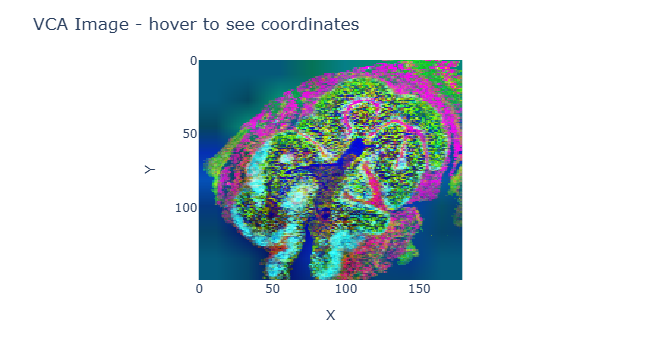

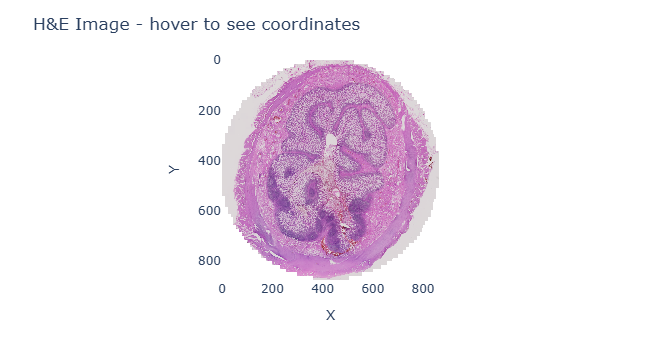

In [ ]:
import plotly.express as px
import numpy as np

fig_vca = px.imshow(
    (rgb_clahe * 255).astype(np.uint8),  
    origin='upper',
    labels={'x':'X', 'y':'Y'},
)
fig_vca.update_layout(title='VCA Image - hover to see coordinates')
fig_vca.show()


fig_he = px.imshow(
    he_rotated,
    origin='upper',
    labels={'x':'X', 'y':'Y'},
)
fig_he.update_layout(title='H&E Image - hover to see coordinates')
fig_he.show()


In [ ]:
# for down sampling use
import numpy as np
from skimage import transform
import matplotlib.pyplot as plt

src = np.array([
    [48, 149],
    [133, 21],
    [111, 55],
    [127, 104],
    [88, 65],
    [46,120],
    [41,93],
    [32,92]
])

dst = np.array([
    [457, 773],
    [449, 120],
    [422, 295],
    [617, 447],
    [394, 380],
    [334,700],
    [262,608],
    [203,605]
])

tform_reverse = transform.estimate_transform('affine', dst, src)  # 注意交换 src 和 dst

he_registered = transform.warp(he_rotated, inverse_map=tform_reverse.inverse,
                               output_shape=rgb_clahe.shape[:2])  # 输出尺寸为 VCA 尺寸

# visal
plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.imshow(rgb_clahe)
plt.title("Original VCA")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(he_rotated)
plt.title("Original H&E")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(he_registered)
plt.title("H&E Registered to VCA")
plt.axis('off')

plt.show()



In [ ]:

src = np.array([
    [48, 149],
    [133, 21],
    [111, 55],
    [127, 104],
    [88, 65]
])

dst = np.array([
    [457, 773],
    [449, 120],
    [422, 295],
    [617, 447],
    [394, 380]
])

tform = transform.estimate_transform('affine', src, dst)

vca_registered = transform.warp(rgb_clahe, inverse_map=tform.inverse,
                                output_shape=he_rotated.shape[:2])

plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.imshow(rgb_clahe)
plt.title("Original VCA")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(he_rotated)
plt.title("H&E")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(vca_registered)
plt.title("VCA Registered to H&E")
plt.axis('off')

plt.show()

In [ ]:
plt.figure(figsize=(6,6))
plt.imshow(he_rotated, alpha=0.5)
plt.imshow(vca_registered, alpha=0.5)
plt.title("Overlay H&E + Registered VCA")
plt.axis('off')
plt.show()
plt.figure(figsize=(6,6))
plt.imshow(vca_registered, alpha=0.5)  # 底层 VCA
plt.imshow(he_rotated, alpha=0.5)      # 上层 H&E
plt.title("Overlay VCA + H&E")
plt.axis('off')
plt.show()

In [ ]:


src = np.array([
    [48, 149],
    [133, 21],
    [111, 55],
    [127, 104],
    [88, 65],
    [46,120],
    [41,93],
    [32,92]
])

dst = np.array([
    [457, 773],
    [449, 120],
    [422, 295],
    [617, 447],
    [394, 380],
    [334,700],
    [262,608],
    [203,605]
])


tform = transform.estimate_transform('affine', src, dst)

print("Affine transformation matrix:\n", tform.params)

# === 3. 将 VCA 图变换到 H&E 坐标系 ===
vca_registered = transform.warp(rgb_clahe, inverse_map=tform.inverse,
                                output_shape=he_rotated.shape[:2])

# === 4. 可视化配准结果 ===
plt.figure(figsize=(18,6))

plt.subplot(1,3,1)
plt.imshow(rgb_clahe)
plt.title("Original VCA")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(he_rotated)
plt.title("H&E")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(vca_registered)
plt.title("VCA Registered to H&E")
plt.axis('off')

plt.tight_layout()
plt.show()



In [ ]:
#升采样
import numpy as np
from skimage import transform
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from skimage.io import imsave


def upscale_vca_to_he(vca_registered, he_shape, k_neighbors=2, preserve_details=True):
    H_he, W_he = he_shape
    H_v, W_v, C = vca_registered.shape
    N_he = H_he * W_he

 
    mask = np.any(vca_registered > 0, axis=2)  
    coords_v = np.array(np.nonzero(mask)).T  # N_valid x 2
    vca_flat = vca_registered[mask]  # N_valid x C

    # KDTree
    nbrs = NearestNeighbors(n_neighbors=k_neighbors, algorithm='auto').fit(coords_v)

    coords_he = np.array([[i, j] for i in range(H_he) for j in range(W_he)])

    distances, indices = nbrs.kneighbors(coords_he)

    if preserve_details:
        weights = 1.0 / (distances + 1e-8)
    else:
        sigma = 0.5
        weights = np.exp(-distances**2 / (2*sigma**2))
    weights /= weights.sum(axis=1, keepdims=True)

    projected_flat = np.zeros((N_he, C))
    for ch in range(C):
        neighbor_vals = vca_flat[indices, ch]  # N_he x k
        projected_flat[:, ch] = (neighbor_vals * weights).sum(axis=1)

    projected = projected_flat.reshape(H_he, W_he, C)
    return np.clip(projected, 0, 1)

H_he, W_he = he_rotated.shape[:2]
projected_highres = upscale_vca_to_he(vca_registered, (H_he, W_he),
                                      k_neighbors=2, preserve_details=True)

plt.figure(figsize=(18,6))
plt.subplot(1,3,1)
plt.imshow(rgb_clahe)
plt.title("Original VCA")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(he_rotated)
plt.title("H&E")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(projected_highres)
plt.title("Projected High-Res VCA")
plt.axis('off')
plt.tight_layout()
plt.show()

imsave("projected_highres_vca.png", (projected_highres*255).astype(np.uint8))


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


mask_out = (labels == 0)  # cluster 0
mask_keep = ~mask_out
mask_3ch = np.stack([mask_keep]*3, axis=-1)

vca_masked = projected_highres.copy()
vca_masked[~mask_3ch] = 0  #

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(projected_highres)
plt.title("Original Projected VCA")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(vca_masked)
plt.title("VCA after masking Cluster 0")
plt.axis('off')
plt.show()


In [ ]:
# cluster 
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2lab
from sklearn.mixture import GaussianMixture


he_lab = rgb2lab(he_rotated)
H, W, C = he_lab.shape
he_flat = he_lab.reshape(-1, 3)

k = 7  
gmm = GaussianMixture(n_components=k, covariance_type='full', random_state=42)
gmm.fit(he_flat)
labels = gmm.predict(he_flat)
labels = labels.reshape(H, W)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(he_rotated)
plt.title("Original H&E")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(labels, cmap='viridis')
plt.title(f"H&E Clustering by GMM (k={k})")
plt.axis('off')
plt.show()

import numpy as np
import matplotlib.pyplot as plt


unique_labels = np.unique(labels)
print("聚类编号:", unique_labels)

cols = 2
rows = int(np.ceil(len(unique_labels) / cols))

fig, axes = plt.subplots(rows, cols, figsize=(8*cols, 6*rows))
axes = axes.ravel()  

for i, lab in enumerate(unique_labels):

    mask = (labels == lab)
    mask_3ch = np.stack([mask]*3, axis=-1)
    
    he_masked = he_rotated.copy()
    he_masked[~mask_3ch] = 0  
    
    axes[i].imshow(he_masked)
    axes[i].set_title(f"Cluster {lab}", fontsize=14)
    axes[i].axis('off')


for j in range(i+1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure

he_float = he_rotated.astype(np.float32) / 255.0  # 归一化到 [0,1]

he_clahe_mild = np.zeros_like(he_float)
for i in range(3):
    he_clahe_mild[:, :, i] = exposure.equalize_adapthist(he_float[:, :, i], clip_limit=0.01)  # 温和增强

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(he_float)
plt.title("Original H&E")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(he_clahe_mild)
plt.title("CLAHE Mild H&E")
plt.axis('off')
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def cluster_weighted_fusion(he_image, vca_image, labels, cluster_weights):
 
    H, W, C = he_image.shape
    fused_image = np.zeros_like(he_image, dtype=float)
    
    unique_labels = np.unique(labels)
    
    for lab in unique_labels:
        w_he, w_vca = cluster_weights.get(lab, (0,0))  # 默认 0，0 -> mask 掉
        mask = (labels == lab)
        mask_3ch = np.stack([mask]*3, axis=-1)
        
        fused_image[mask_3ch] = (he_image[mask_3ch]*w_he + vca_image[mask_3ch]*w_vca)
    

    fused_image = np.clip(fused_image, 0, 1)
    return fused_image

cluster_weights = {
    0: (0, 0),       
    1: (1, 0),
    2: (0.9, 0.1),
    3: (0, 0.9),
    4: (0, 0),
    5: (1, 0),
    6: (0.1, 0.9)
}


he_float = he_clahe_mild.astype(float)  
vca_float = projected_highres.astype(float)  

fused_image = cluster_weighted_fusion(he_float, vca_float, labels, cluster_weights)

plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.imshow(he_float)
plt.title("Mild H&E")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(projected_highres)
plt.title("Projected High-Res VCA")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(fused_image)
plt.title("Cluster Weighted Fusion")
plt.axis('off')
plt.show()


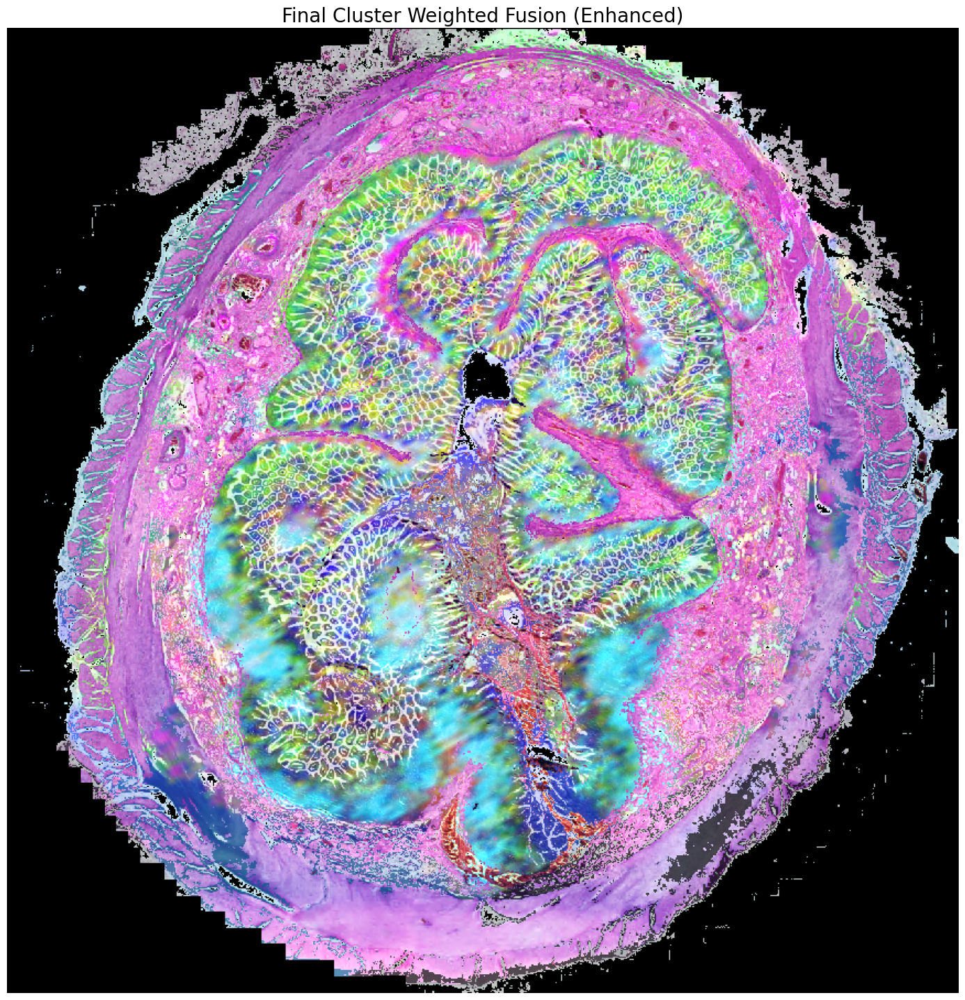

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure

def cluster_weighted_fusion(he_image, vca_image, labels, cluster_weights):

    H, W, C = he_image.shape
    fused_image = np.zeros_like(he_image, dtype=float)
    
    for lab in np.unique(labels):
        w_he, w_vca = cluster_weights.get(lab, (0,0))
        mask = (labels == lab)
        mask_3ch = np.stack([mask]*3, axis=-1)
        fused_image[mask_3ch] = he_image[mask_3ch]*w_he + vca_image[mask_3ch]*w_vca
    
    return np.clip(fused_image, 0, 1)

cluster_weights = {
    0: (0, 0),
    1: (1, 0),
    2: (0.7, 0.3),
    3: (0.3, 0.7),
    4: (0, 0),
    5: (1, 0),
    6: (0.3, 0.7)
}

# 使用 mild H&E
he_float = he_clahe_mild.astype(float)  # [0,1]
vca_float = projected_highres.astype(float)  # [0,1]

fused_image = cluster_weighted_fusion(he_float, vca_float, labels, cluster_weights)

fused_enhanced = np.zeros_like(fused_image)
for i in range(3):
    p2, p98 = np.percentile(fused_image[:, :, i], (2, 98))
    fused_enhanced[:, :, i] = exposure.rescale_intensity(fused_image[:, :, i], in_range=(p2, p98))
-
plt.figure(figsize=(18,18))
plt.imshow(fused_enhanced)
plt.title("Final Cluster Weighted Fusion (Enhanced)", fontsize=20)
plt.axis('off')
plt.show()


In [ ]:
H, W, C = fused_image.shape

fused_lab = rgb2lab(fused_image)
fused_flat = fused_lab.reshape(-1, 3)

k = 7  
gmm = GaussianMixture(n_components=k, covariance_type='full', random_state=42)
gmm.fit(fused_flat)
labels_fused = gmm.predict(fused_flat).reshape(H, W)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(fused_image)
plt.title("Fused Image")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(labels_fused, cmap='viridis')
plt.title(f"Fused Image Clustering (k={k})")
plt.axis('off')
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2lab
from sklearn.mixture import GaussianMixture


H, W, C = fused_image.shape

fused_lab = rgb2lab(fused_image)
fused_flat = fused_lab.reshape(-1, 3)

k = 8  
gmm = GaussianMixture(n_components=k, covariance_type='full', random_state=42)
gmm.fit(fused_flat)
labels_fused = gmm.predict(fused_flat).reshape(H, W)

unique_labels = np.unique(labels_fused)
print("聚类编号:", unique_labels)

cols = 2
rows = int(np.ceil(len(unique_labels) / cols))
fig, axes = plt.subplots(rows, cols, figsize=(8*cols, 6*rows))
axes = axes.ravel()  

for i, lab in enumerate(unique_labels):
    mask = (labels_fused == lab)
    mask_3ch = np.stack([mask]*3, axis=-1)
    
    fused_masked = fused_image.copy()
    fused_masked[~mask_3ch] = 0  
    
    axes[i].imshow(fused_masked)
    axes[i].set_title(f"Cluster {lab}", fontsize=14)
    axes[i].axis('off')

for j in range(i+1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()
